In [25]:
import yaml
import h5py
import numpy as np
import sys
import os
import numpy as np
import matplotlib.pyplot as plt
from importlib import reload
import nibabel as nib
import pandas as pd
from IPython.display import clear_output

In [4]:
sys.path.insert(1, "/Users/dvarelat/Documents/MASTER/TFM/methods")
import util_daniela as u

In [5]:
full_spec = "/Users/dvarelat/Documents/MASTER/TFM/DATA/20190401_E2_down/20190401_E2_mGFP_decon_0.5.nii.gz"

In [7]:
img_zyx = u.read_nii_XYZ(full_spec)
img_zyx = img_zyx[:,:,:,0]
img_zyx.shape

Rotating axes: zyx


(566, 1024, 1024)

### Convert to H5

In [ ]:

save_path = "/Users/dvarelat/Documents/MASTER/TFM/DATA/20190401_E2_down/20190401_E2_mGFP_decon_0.5.h5" 
hf = h5py.File(save_path, 'a')
dset = hf.create_dataset('raw', data=img_zyx) 
hf.close() 
print('hdf5 file size: %d bytes'%os.path.getsize(save_path))

In [ ]:
# u.convert_nii_h5(full_spec, save_path)

## check prediction

In [13]:
pred = "/Users/dvarelat/Documents/MASTER/TFM/methods/pytorch3dunet/20190401_E2_mGFP_decon_0.5_zyx_predictions.h5"

In [14]:
full_pred = np.array(h5py.File(pred, 'r')["predictions"])
full_pred = full_pred[0,:,:,:]
full_pred.shape

(566, 1024, 1024)

In [30]:
print(plt.style.available)

['Solarize_Light2', '_classic_test_patch', '_mpl-gallery', '_mpl-gallery-nogrid', 'bmh', 'classic', 'dark_background', 'fast', 'fivethirtyeight', 'ggplot', 'grayscale', 'seaborn', 'seaborn-bright', 'seaborn-colorblind', 'seaborn-dark', 'seaborn-dark-palette', 'seaborn-darkgrid', 'seaborn-deep', 'seaborn-muted', 'seaborn-notebook', 'seaborn-paper', 'seaborn-pastel', 'seaborn-poster', 'seaborn-talk', 'seaborn-ticks', 'seaborn-white', 'seaborn-whitegrid', 'tableau-colorblind10']


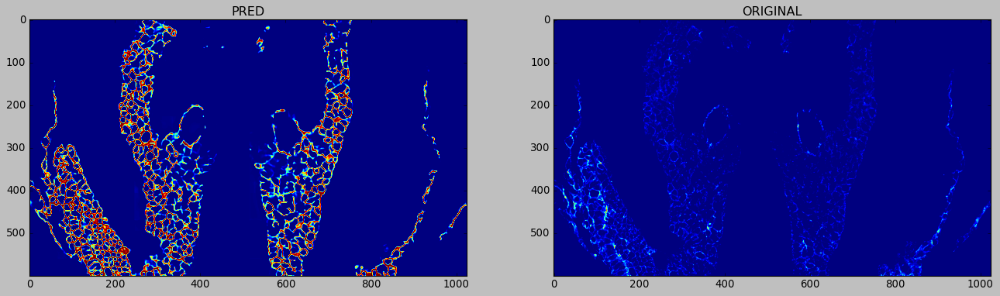

In [46]:
n = 300
plt.rcParams.update(plt.rcParamsDefault)

plt.style.use('∑')
plt.figure(figsize=(20,20)) 
plots = [full_pred[n, 200:800, :], img_zyx[n, 200:800, :]]
titles =["PRED", "ORIGINAL"]
for i in range(len(plots)):
    plt.subplot(1,len(plots),i+1).set_title(titles[i]) 
    plt.imshow(plots[i])
plt.show()

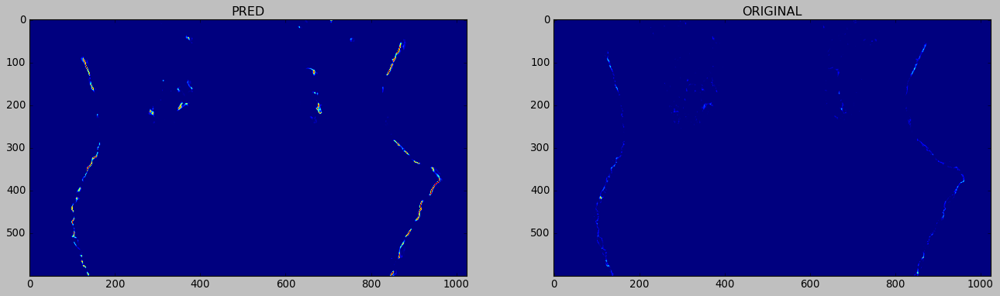

In [47]:

for t in range(50):
    plt.figure(figsize=(20,20)) 
    n = 10*t
    #print(n)
    plots = [full_pred[n, 200:800, :], img_zyx[n, 200:800, :]]
    titles =["PRED", "ORIGINAL"]
    for i in range(len(plots)):
        plt.subplot(1,len(plots), i+1).set_title(titles[i]) 
        plt.imshow(plots[i])
    plt.show()
    clear_output(wait=True)

In [20]:
labels = (full_pred > 0.5).astype('float64') 


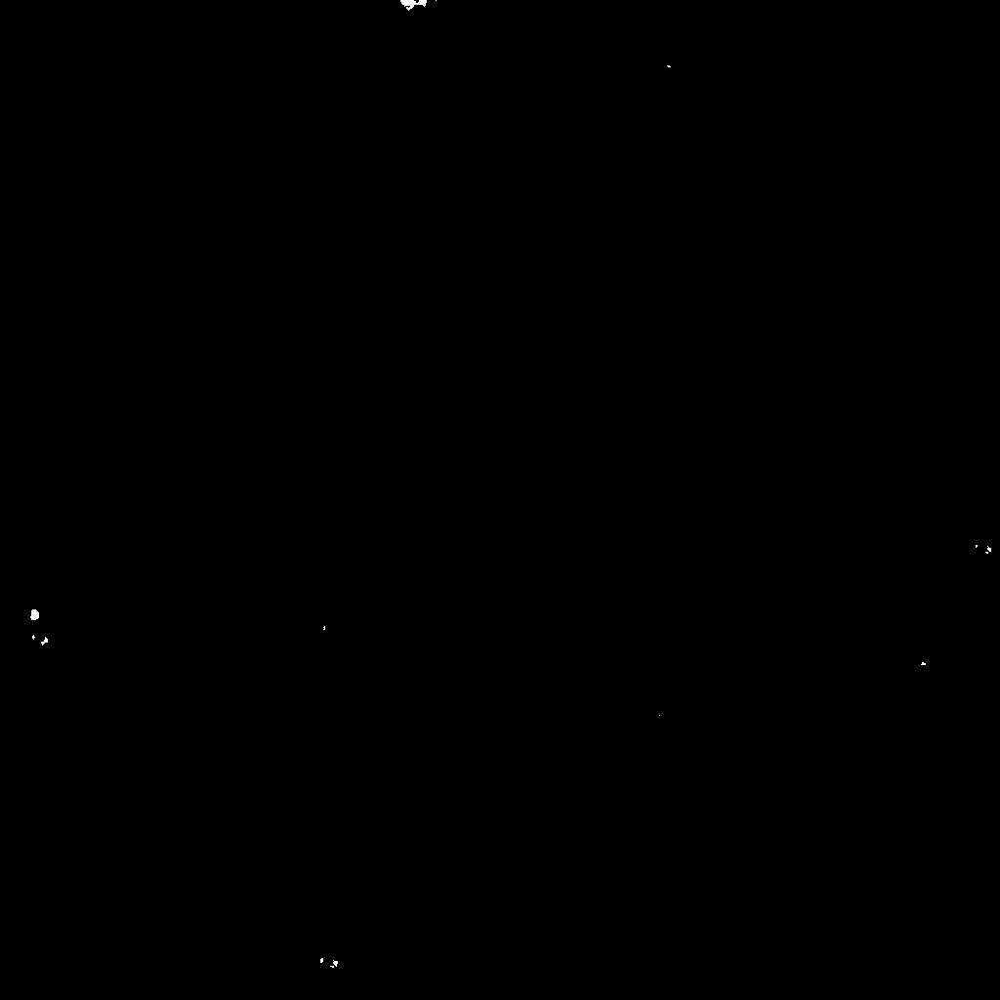
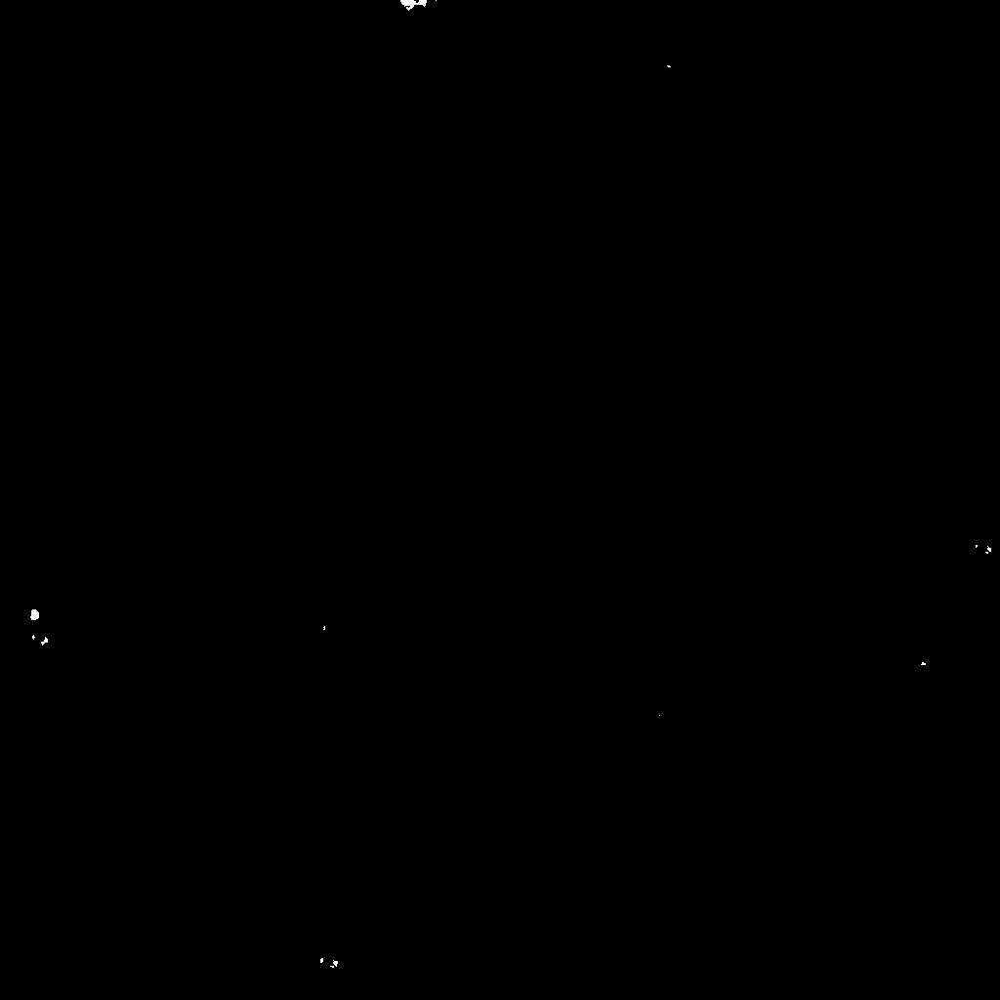
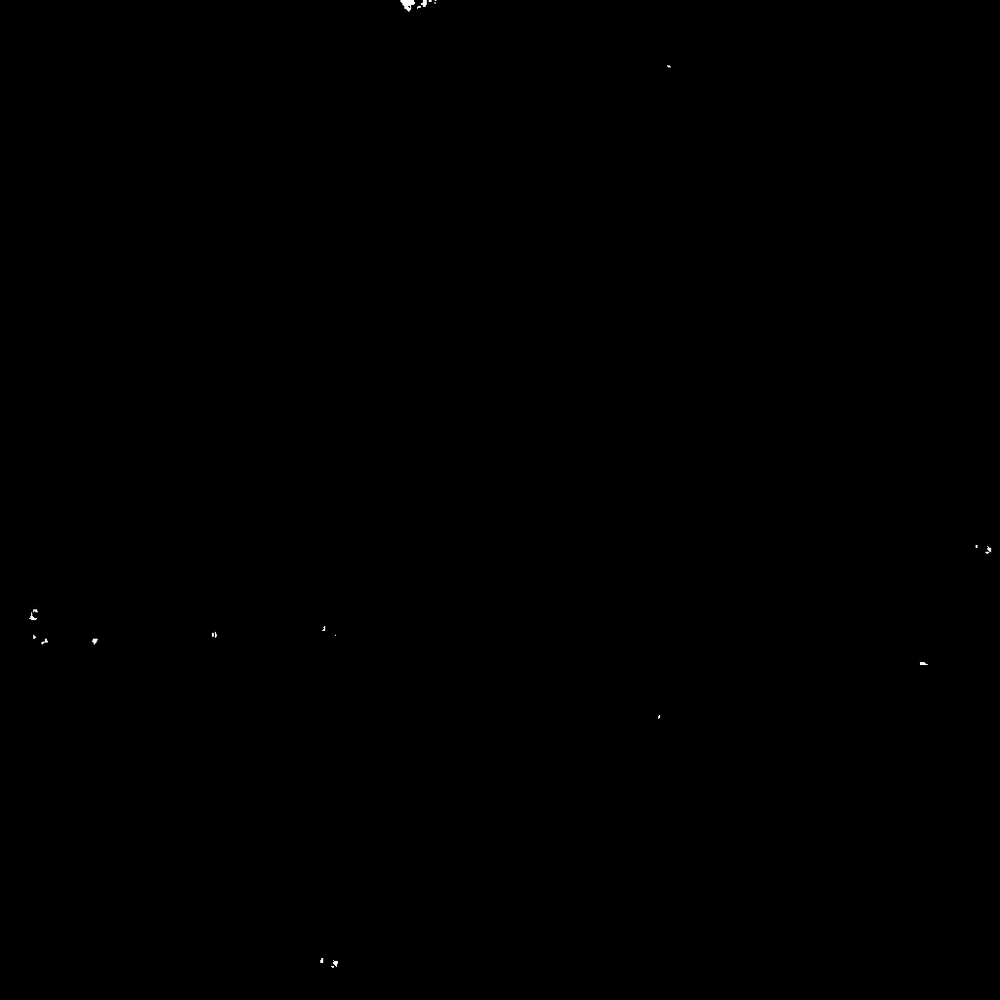
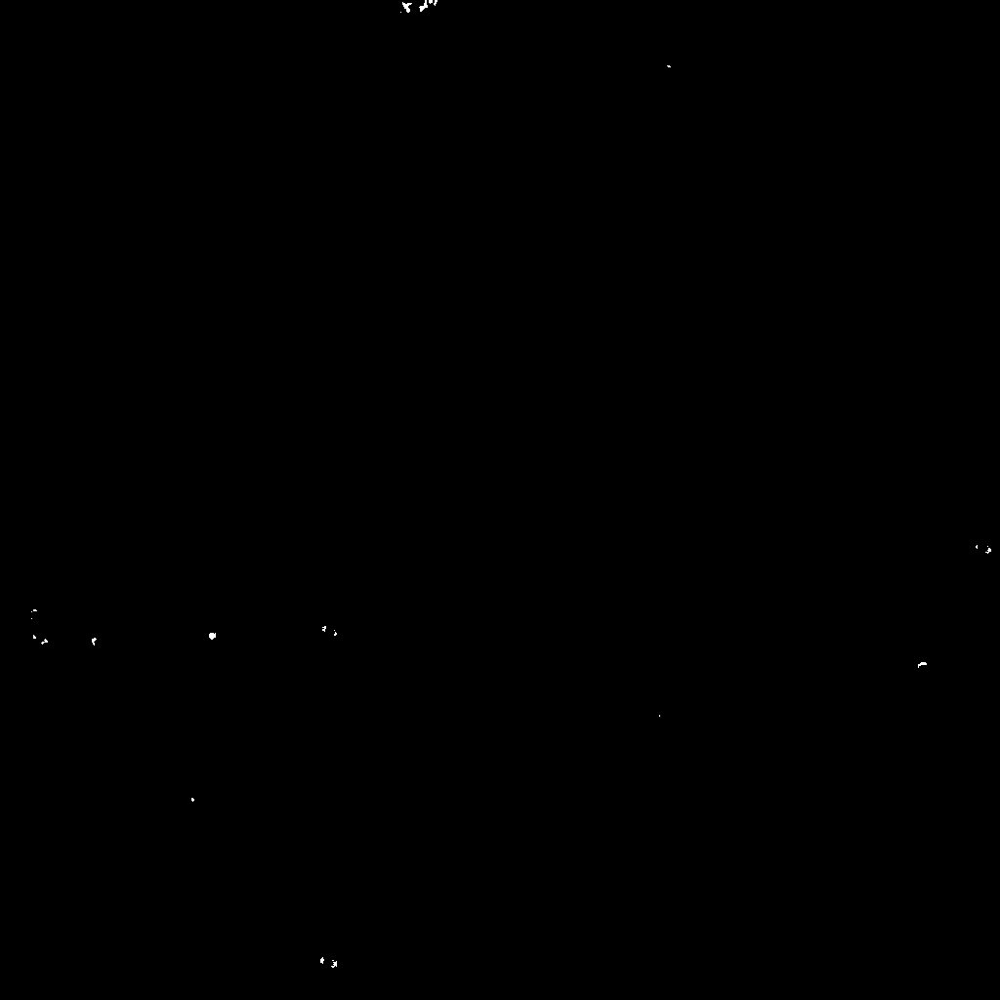
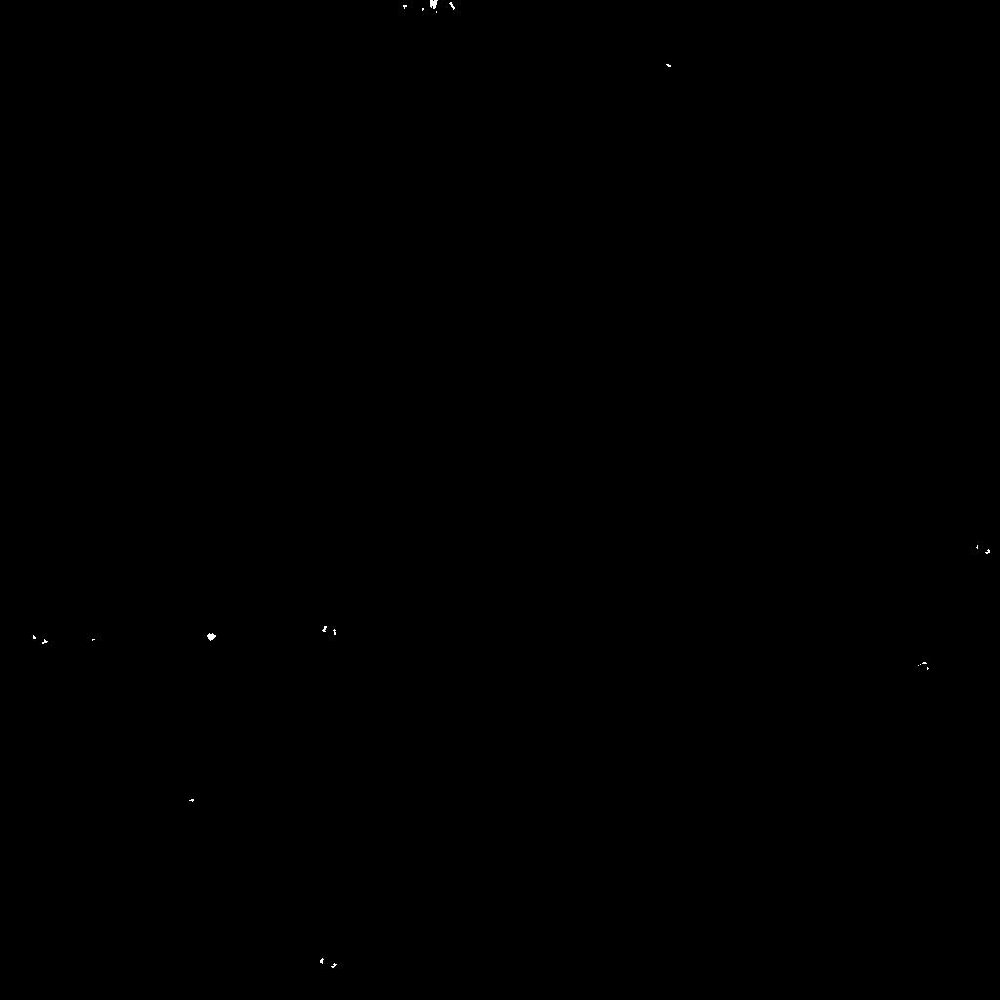
...
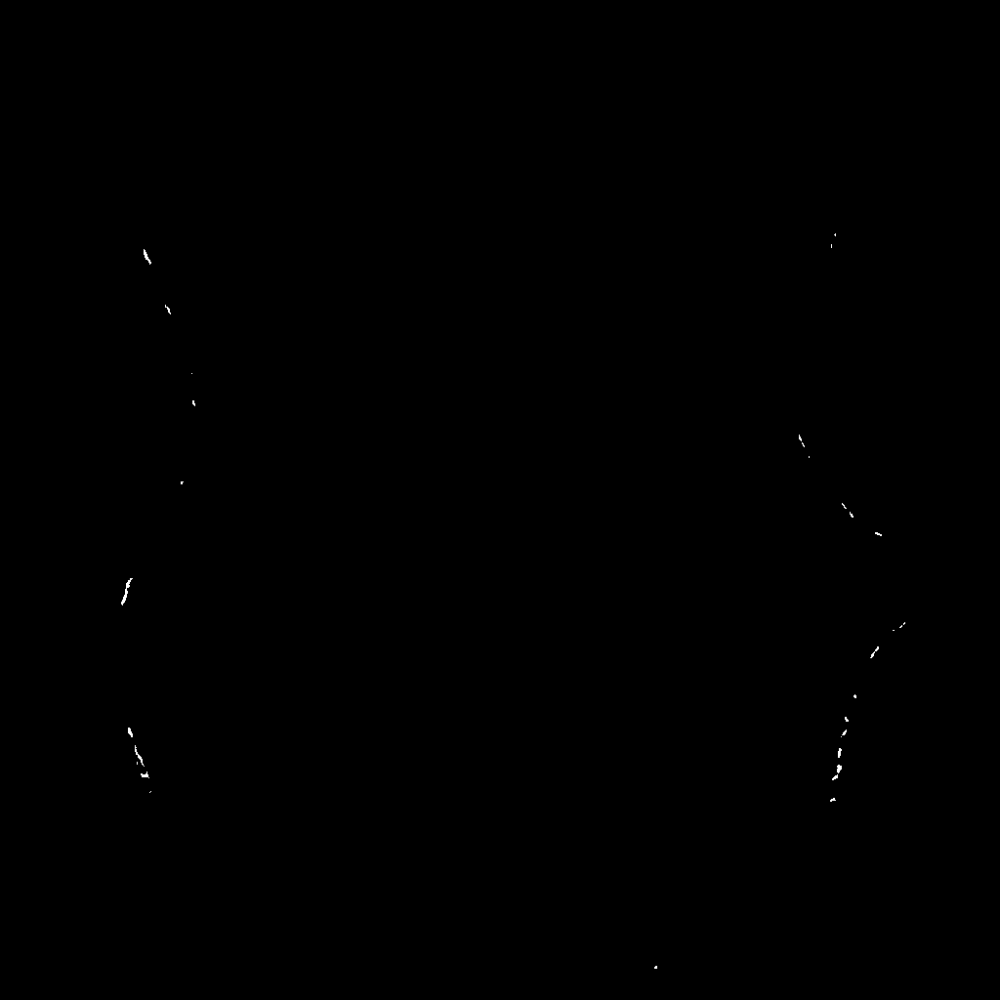
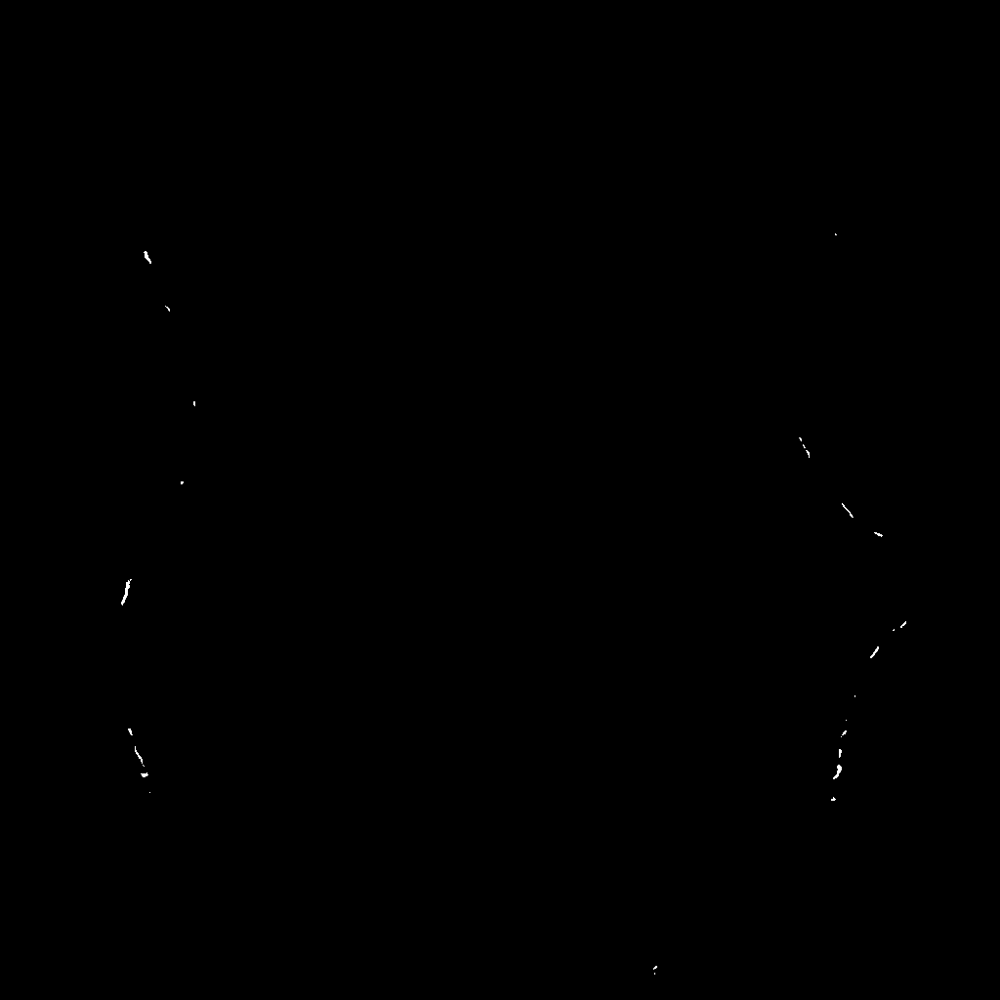
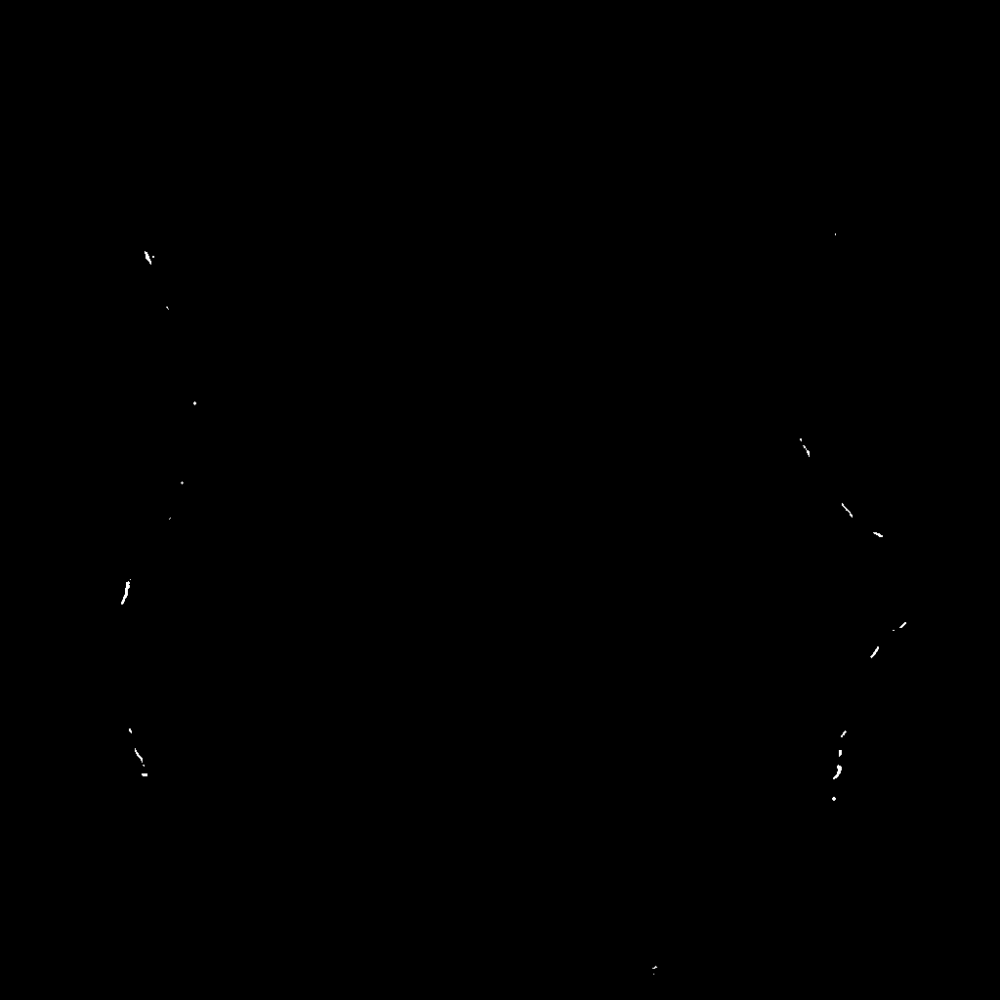
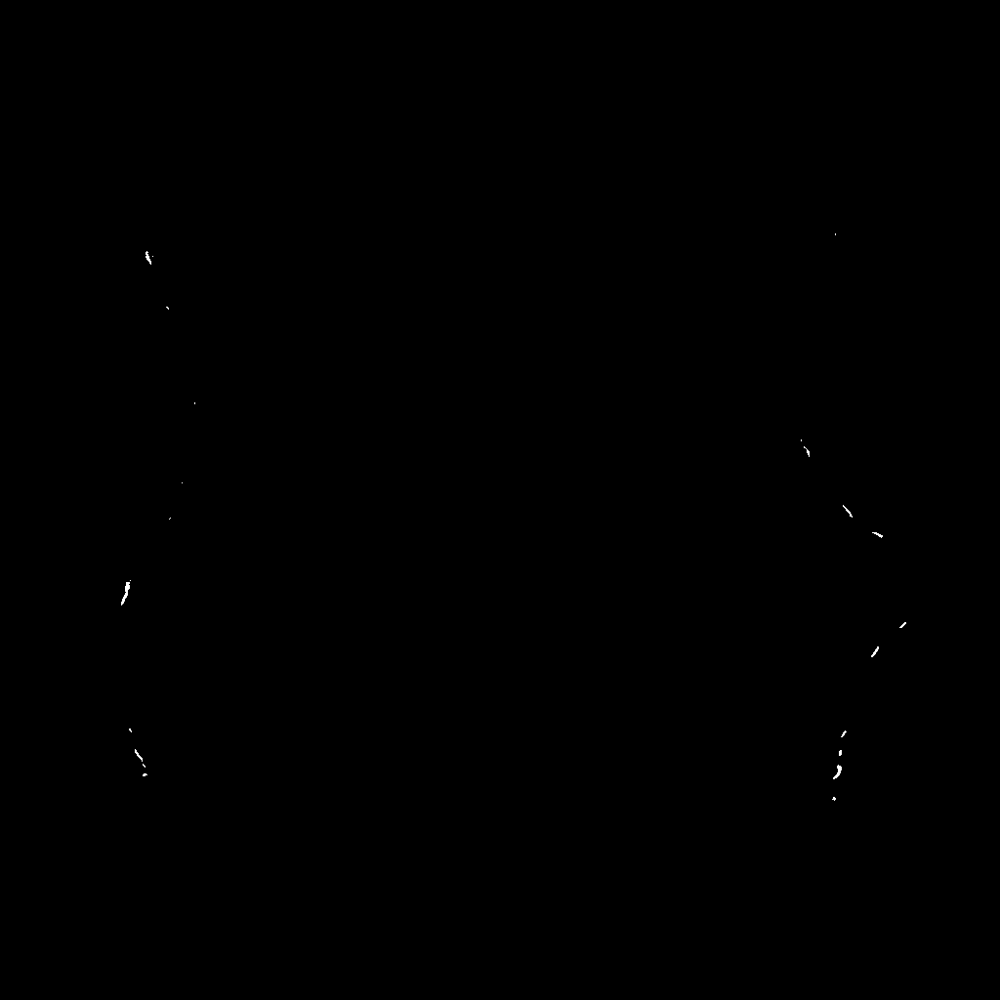
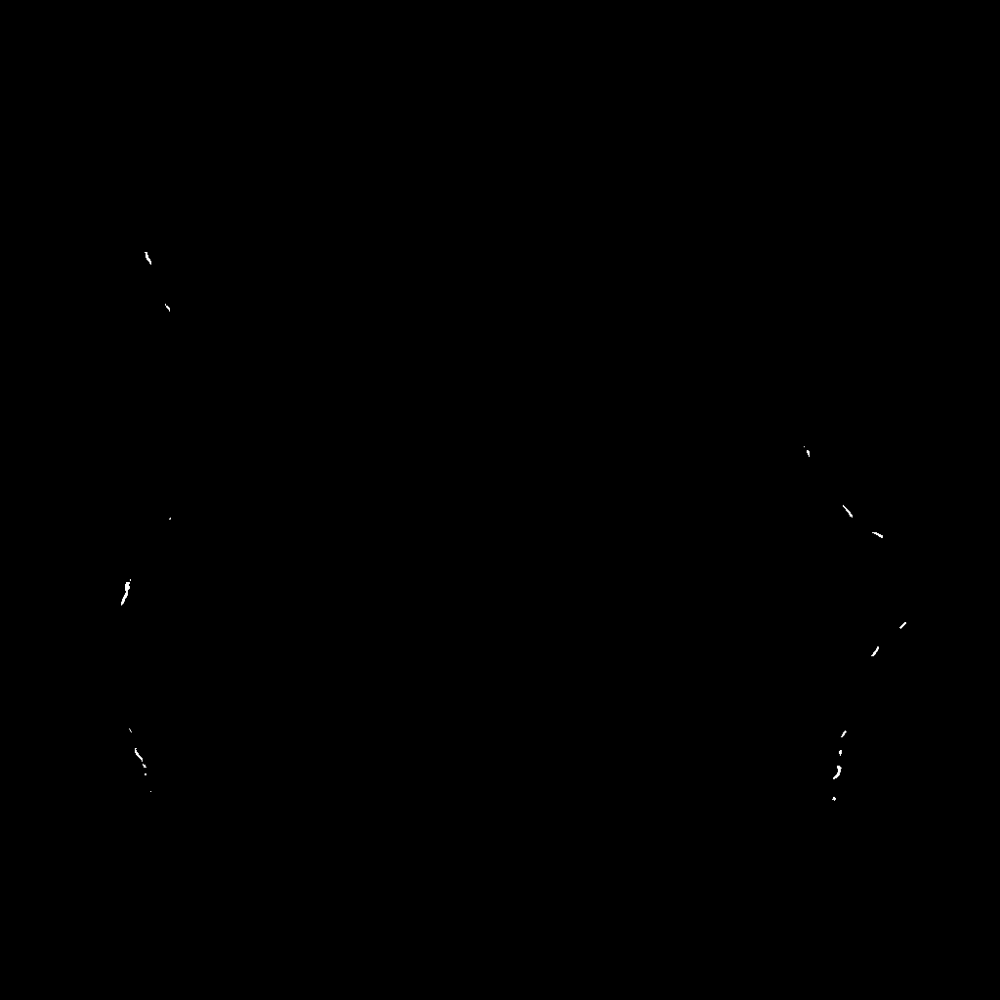

In [49]:
fig = px.imshow(labels, animation_frame=0, binary_string=True, labels=dict(animation_frame="slice"))
fig.show()

## guardar pred como nii.gz

In [21]:
ni_img = nib.Nifti1Image(np.swapaxes(labels[:,:,:],0,2), affine=np.eye(4))
nib.save(ni_img, "/Users/dvarelat/Documents/MASTER/TFM/methods/pytorch3dunet/20190401_E2_mGFP_decon_0.5_xyz_labels.nii.gz")

## check GASP

In [8]:
gasp = "/Users/dvarelat/Documents/MASTER/TFM/methods/postpro/20190401_E2_mGFP_decon_0.5_xyz_predictions_GASP.nii.gz"

In [11]:
gasp_zyx = u.read_nii_XYZ(gasp)
gasp_zyx.shape

Rotating axes: zyx


(566, 1024, 1024)

In [18]:
np.swapaxes(gasp_zyx[:,:,:],0,1).shape

(1024, 1024, 566)

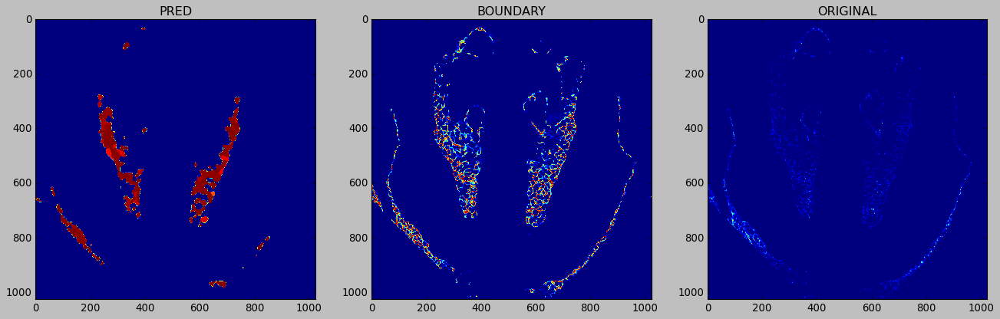

In [22]:
plt.style.use('classic')

n = 350
plt.figure(figsize=(20,20)) 
plots = [gasp_zyx[n, :, :], full_pred[n, :, :], img_zyx[n, :, :]]
titles =["PRED", "BOUNDARY", "ORIGINAL"]
for i in range(len(plots)):
    plt.subplot(1,len(plots),i+1).set_title(titles[i]) 
    plt.imshow(plots[i])
plt.show()

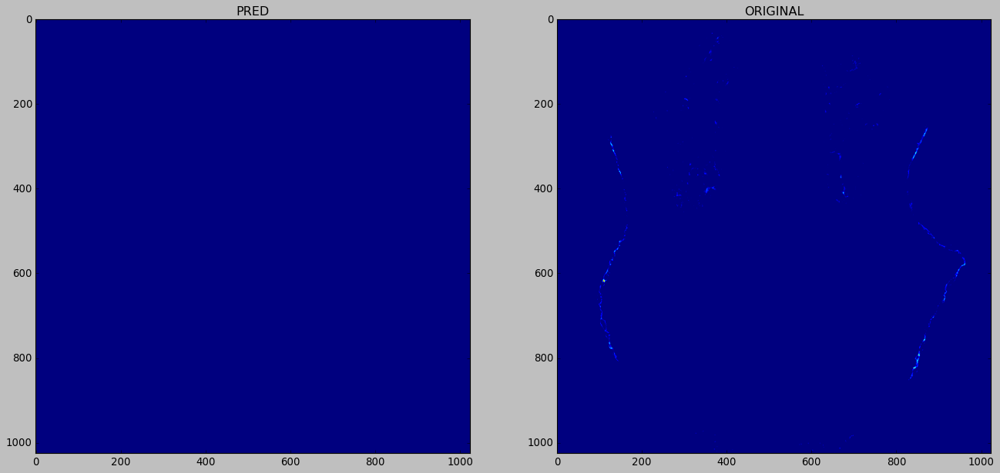

In [50]:
for t in range(50):
    plt.figure(figsize=(20,20)) 
    n = 10*t
    #print(n)
    plots = [np.swapaxes(gasp_zyx[:,:,:],0,1)[:, :, n], img_zyx[n, :, :]]
    for i in range(len(plots)):
        plt.subplot(1,len(plots), i+1).set_title(titles[i]) 
        plt.imshow(plots[i])
    plt.show()
    clear_output(wait=True)

In [24]:
print(plt.style.available)

['Solarize_Light2', '_classic_test_patch', '_mpl-gallery', '_mpl-gallery-nogrid', 'bmh', 'classic', 'dark_background', 'fast', 'fivethirtyeight', 'ggplot', 'grayscale', 'seaborn', 'seaborn-bright', 'seaborn-colorblind', 'seaborn-dark', 'seaborn-dark-palette', 'seaborn-darkgrid', 'seaborn-deep', 'seaborn-muted', 'seaborn-notebook', 'seaborn-paper', 'seaborn-pastel', 'seaborn-poster', 'seaborn-talk', 'seaborn-ticks', 'seaborn-white', 'seaborn-whitegrid', 'tableau-colorblind10']


# check MULTICUT

In [2]:
multicut = "/Users/dvarelat/Documents/MASTER/TFM/methods/postpro/20190401_E2_mGFP_decon_0.5_xyz_predictions_MULTICUT.nii.gz"

In [20]:
multicut_zyx = u.read_nii_XYZ(gasp)
multicut_zyx.shape

Rotating axes: zyx


(566, 1024, 1024)

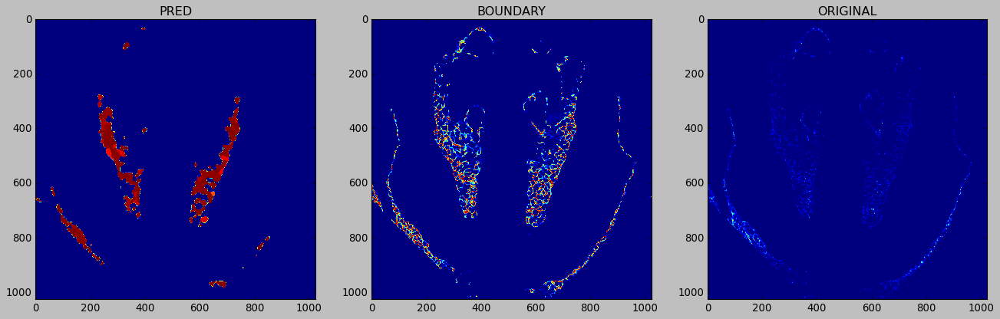

In [23]:
plt.style.use('classic')

n = 350
plt.figure(figsize=(20,20)) 
plots = [multicut_zyx[n, :, :], full_pred[n, :, :], img_zyx[n, :, :]]
titles =["PRED", "BOUNDARY", "ORIGINAL"]
for i in range(len(plots)):
    plt.subplot(1,len(plots),i+1).set_title(titles[i]) 
    plt.imshow(plots[i])
plt.show()

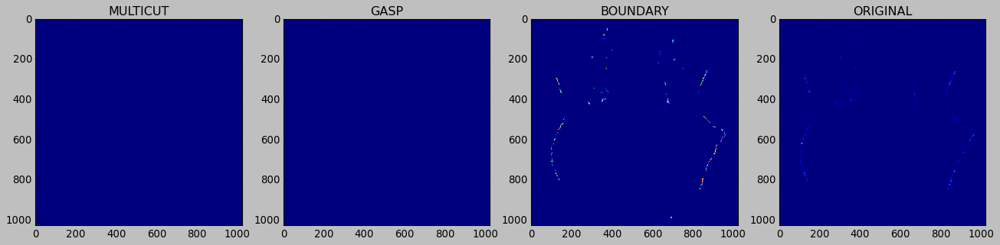

In [26]:
for t in range(50):
    plt.figure(figsize=(20,20)) 
    n = 10*t
    #print(n)
    plots = [multicut_zyx[n, :, :], gasp_zyx[n, :, :],  full_pred[n, :, :], img_zyx[n, :, :]]
    titles =["MULTICUT", "GASP", "BOUNDARY", "ORIGINAL"]
    for i in range(len(plots)):
        plt.subplot(1,len(plots), i+1).set_title(titles[i]) 
        plt.imshow(plots[i])
    plt.show()
    clear_output(wait=True)